In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from matplotlib import style

In [3]:
df1 = pd.read_csv ("data/Soal-01.csv")
df1.head(20)

,provinsi,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting
0,JAWA BARAT,3201,Kabupaten Bogor,2015,26.223776
1,JAWA BARAT,3201,Kabupaten Bogor,2016,28.750000
2,JAWA BARAT,3201,Kabupaten Bogor,2017,28.440340
3,JAWA BARAT,3202,Kabupaten Sukabumi,2015,28.301887
4,JAWA BARAT,3202,Kabupaten Sukabumi,2016,25.242718
5,JAWA BARAT,3202,Kabupaten Sukabumi,2017,37.617645
6,JAWA BARAT,3203,Kabupaten Cianjur,2015,36.526946
7,JAWA BARAT,3203,Kabupaten Cianjur,2016,33.040936
8,JAWA BARAT,3203,Kabupaten Cianjur,2017,35.714353
9,JAWA BARAT,3204,Kabupaten Bandung,2015,32.835821


In [4]:
df1.columns

Index(['provinsi', 'kode_kota_kabupaten', 'nama_kota_kabupaten', 'tahun',
       'prevalensi_stunting'],
      dtype='object')

In [5]:
df1.index

RangeIndex(start=0, stop=81, step=1)

In [6]:
df1 = pd.read_csv("data/Soal-01.csv")
df1.head()

,provinsi,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting
0,JAWA BARAT,3201,Kabupaten Bogor,2015,26.223776
1,JAWA BARAT,3201,Kabupaten Bogor,2016,28.750000
2,JAWA BARAT,3201,Kabupaten Bogor,2017,28.440340
3,JAWA BARAT,3202,Kabupaten Sukabumi,2015,28.301887
4,JAWA BARAT,3202,Kabupaten Sukabumi,2016,25.242718


In [7]:
df12 = round(df1.describe(), 0)
df12

,kode_kota_kabupaten,tahun,prevalensi_stunting
count,81.0,81.0,81.0
mean,3231.0,2016.0,27.0
std,31.0,1.0,7.0
min,3201.0,2015.0,8.0
25%,3207.0,2015.0,23.0
50%,3214.0,2016.0,27.0
75%,3273.0,2017.0,31.0
max,3279.0,2017.0,43.0


In [8]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 81 entries, 0 to 80
Data columns (total 5 columns):
provinsi               81 non-null object
kode_kota_kabupaten    81 non-null int64
nama_kota_kabupaten    81 non-null object
tahun                  81 non-null int64
prevalensi_stunting    81 non-null float64
dtypes: float64(1), int64(2), object(2)
memory usage: 3.3+ KB


In [9]:
df1.tahun.value_counts()

2017    27
2016    27
2015    27
Name: tahun, dtype: int64

In [10]:
df1.nama_kota_kabupaten.unique()

array(['Kabupaten Bogor', 'Kabupaten Sukabumi', 'Kabupaten Cianjur',
       'Kabupaten Bandung', 'Kabupaten Garut', 'Kabupaten Tasikmalaya',
       'Kabupaten Ciamis', 'Kabupaten Kuningan', 'Kabupaten Cirebon',
       'Kabupaten Majalengka', 'Kabupaten Sumedang',
       'Kabupaten Indramayu', 'Kabupaten Subang', 'Kabupaten Purwakarta',
       'Kabupaten Karawang', 'Kabupatenbekasi', 'Kabupaten Bandung Barat',
       'Kabupaten Pangandaran', 'Kota Bogor', 'Kota Sukabumi',
       'Kota Bandung', 'Kota Cirebon', 'Kota Bekasi', 'Kota Depok',
       'Kota Cimahi', 'Kota Tasikmalaya', 'Kota Banjar'], dtype=object)

In [11]:
df1.isna().sum()

provinsi               0
kode_kota_kabupaten    0
nama_kota_kabupaten    0
tahun                  0
prevalensi_stunting    0
dtype: int64

# Bagi DF Berdasarkan Tahun (2015, 2016, 2017)

In [24]:
df2015 = df1[df1.tahun == 2015]
df2015.sort_values("prevalensi_stunting", ascending=True, inplace= True)
df2015.head()

C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,provinsi,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting
69,JAWA BARAT,3276,Kota Depok,2015,7.807808
54,JAWA BARAT,3271,Kota Bogor,2015,10.416667
66,JAWA BARAT,3275,Kota Bekasi,2015,11.799410
63,JAWA BARAT,3274,Kota Cirebon,2015,18.437500
36,JAWA BARAT,3213,Kabupaten Subang,2015,22.049689


In [13]:
nama_kota_kabupaten = df2015['nama_kota_kabupaten'].values.tolist()
nama_kota_kabupaten

['Kabupaten Cianjur',
 'Kota Sukabumi',
 'Kabupaten Garut',
 'Kabupaten Tasikmalaya',
 'Kabupaten Bandung',
 'Kabupaten Majalengka',
 'Kota Tasikmalaya',
 'Kabupaten Bandung Barat',
 'Kabupaten Karawang',
 'Kabupaten Cirebon',
 'Kabupaten Sukabumi',
 'Kabupaten Sumedang',
 'Kabupaten Purwakarta',
 'Kabupaten Ciamis',
 'Kabupaten Bogor',
 'Kabupaten Pangandaran',
 'Kota Bandung',
 'Kabupaten Indramayu',
 'Kota Cimahi',
 'Kabupaten Kuningan',
 'Kabupatenbekasi',
 'Kota Banjar',
 'Kabupaten Subang',
 'Kota Cirebon',
 'Kota Bekasi',
 'Kota Bogor',
 'Kota Depok']

In [14]:
stunting_2015 = df2015['prevalensi_stunting'].values.tolist()
stunting_2015

[36.52694611,
 34.50479233,
 33.74233129,
 33.00970874,
 32.835820899999995,
 32.06349206,
 32.01219512,
 29.61783439,
 29.44983819,
 28.83435583,
 28.30188679,
 27.15231788,
 26.85714286,
 26.79738562,
 26.22377622,
 25.42372881,
 25.16703786,
 23.7804878,
 23.69230769,
 23.41772152,
 22.42424242,
 22.402597399999998,
 22.04968944,
 18.4375,
 11.79941003,
 10.41666667,
 7.807807808]

## Visualisasi Bar Chart 2015

Text(0.5, 1.0, 'Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2015')

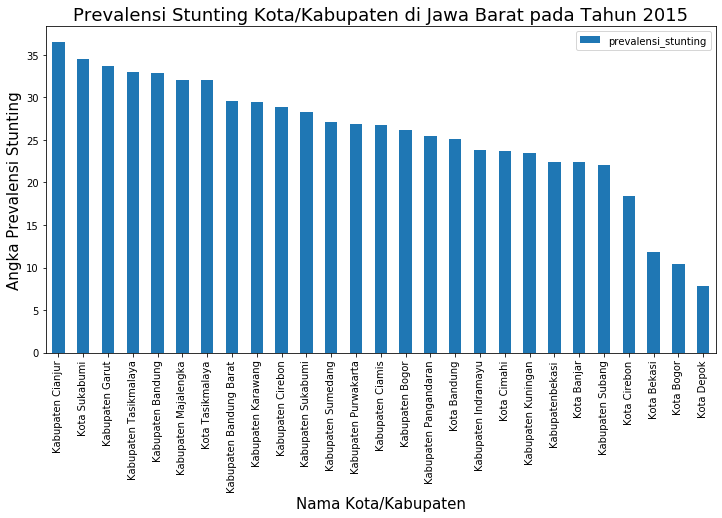

In [16]:
df2015.head()
df2015.plot.bar(x= 'nama_kota_kabupaten', y='prevalensi_stunting')
plt.rcParams['figure.figsize'] = [12, 6]
plt.ylabel("Angka Prevalensi Stunting", fontsize= 15)
plt.xlabel("Nama Kota/Kabupaten", fontsize= 15)
plt.title("Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2015", fontsize= 18)

In [22]:
df2016 = df1[df1.tahun == 2016]
df2016.sort_values("prevalensi_stunting", ascending=False, inplace= True)
df2016.head()

C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,provinsi,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting
22,JAWA BARAT,3208,Kabupaten Kuningan,2016,33.333333
7,JAWA BARAT,3203,Kabupaten Cianjur,2016,33.040936
49,JAWA BARAT,3217,Kabupaten Bandung Barat,2016,32.601881
10,JAWA BARAT,3204,Kabupaten Bandung,2016,32.121212
76,JAWA BARAT,3278,Kota Tasikmalaya,2016,30.937500


## Visualisasi Bar Chart 2016

In [18]:
stunting_2016 = df2016['prevalensi_stunting'].values.tolist()
stunting_2016

[33.33333333,
 33.04093567,
 32.60188088,
 32.12121212,
 30.9375,
 30.6501548,
 30.21148036,
 29.9382716,
 29.53846154,
 28.96341463,
 28.75,
 26.82926829,
 25.24271845,
 24.92211838,
 24.33234421,
 24.29022082,
 22.600619199999997,
 22.5,
 22.15384615,
 21.94357367,
 20.50473186,
 20.26143791,
 20.18927445,
 18.70967742,
 18.29268293,
 15.96385542,
 8.814589666]

Text(0.5, 1.0, 'Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2016')

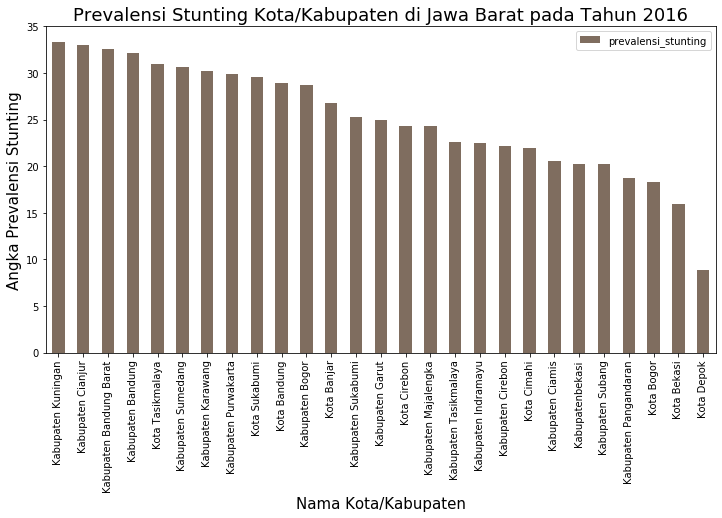

In [19]:
df2016.head()
df2016.plot.bar(x= 'nama_kota_kabupaten', y='prevalensi_stunting', color='#7f6d5f')
plt.rcParams['figure.figsize'] = [12, 6]
plt.ylabel("Angka Prevalensi Stunting", fontsize= 15)
plt.xlabel("Nama Kota/Kabupaten", fontsize= 15)
plt.title("Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2016", fontsize= 18)

In [23]:
df2017 = df1[df1.tahun == 2017]

df2017.sort_values("prevalensi_stunting", ascending=False, inplace= True)
df2017.head()

C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


,provinsi,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting
14,JAWA BARAT,3205,Kabupaten Garut,2017,43.167625
11,JAWA BARAT,3204,Kabupaten Bandung,2017,38.699558
77,JAWA BARAT,3278,Kota Tasikmalaya,2017,38.216196
5,JAWA BARAT,3202,Kabupaten Sukabumi,2017,37.617645
8,JAWA BARAT,3203,Kabupaten Cianjur,2017,35.714353


## Visualisasi Bar Chart 2017

In [93]:
stunting_2017 = df2017['prevalensi_stunting'].values.tolist()
stunting_2017

[43.16762545,
 38.69955808,
 38.21619557,
 37.61764523,
 35.714353499999994,
 34.26808786,
 33.33356025,
 30.84130062,
 30.24629003,
 29.93619805,
 28.96577609,
 28.52521837,
 28.44033956,
 28.12541873,
 28.12436497,
 28.0,
 26.50570342,
 26.11489625,
 25.7575532,
 25.63285246,
 25.54546146,
 25.46060497,
 25.00052728,
 23.67607429,
 23.07825785,
 15.01491667,
 14.88125919]

Text(0.5, 1.0, 'Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2017')

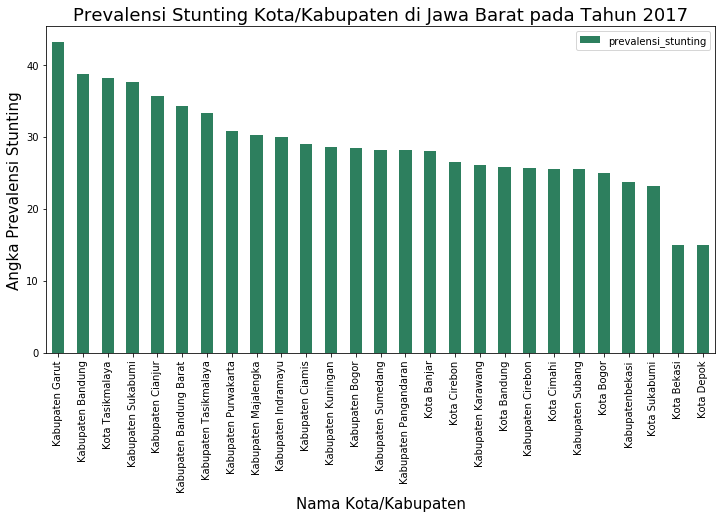

In [130]:
df2017.head()
df2017.plot.bar(x= 'nama_kota_kabupaten', y='prevalensi_stunting', color='#2d7f5e')
plt.rcParams['figure.figsize'] = [12, 8]
plt.ylabel("Angka Prevalensi Stunting", fontsize= 15)
plt.xlabel("Nama Kota/Kabupaten", fontsize= 15)
plt.title("Prevalensi Stunting Kota/Kabupaten di Jawa Barat pada Tahun 2017", fontsize= 18)

In [26]:
df1["Kondisi"] = pd.cut(df1.prevalensi_stunting, bins= [7, 23, 30, 45], labels= ["Rendah", "Sedang", "Kritis"])
df1.head(10)

,kode_kota_kabupaten,nama_kota_kabupaten,tahun,prevalensi_stunting,Kondisi
0,3201,Kabupaten Bogor,2015,26.223776,Sedang
1,3201,Kabupaten Bogor,2016,28.750000,Sedang
2,3201,Kabupaten Bogor,2017,28.440340,Sedang
3,3202,Kabupaten Sukabumi,2015,28.301887,Sedang
4,3202,Kabupaten Sukabumi,2016,25.242718,Sedang
5,3202,Kabupaten Sukabumi,2017,37.617645,Kritis
6,3203,Kabupaten Cianjur,2015,36.526946,Kritis
7,3203,Kabupaten Cianjur,2016,33.040936,Kritis
8,3203,Kabupaten Cianjur,2017,35.714353,Kritis
9,3204,Kabupaten Bandung,2015,32.835821,Kritis


Text(0.5, 1.0, 'Prevalensi Stunting Kabupaten/Kota di Jawa Barat pada tahun 2015, 2016, 2017')

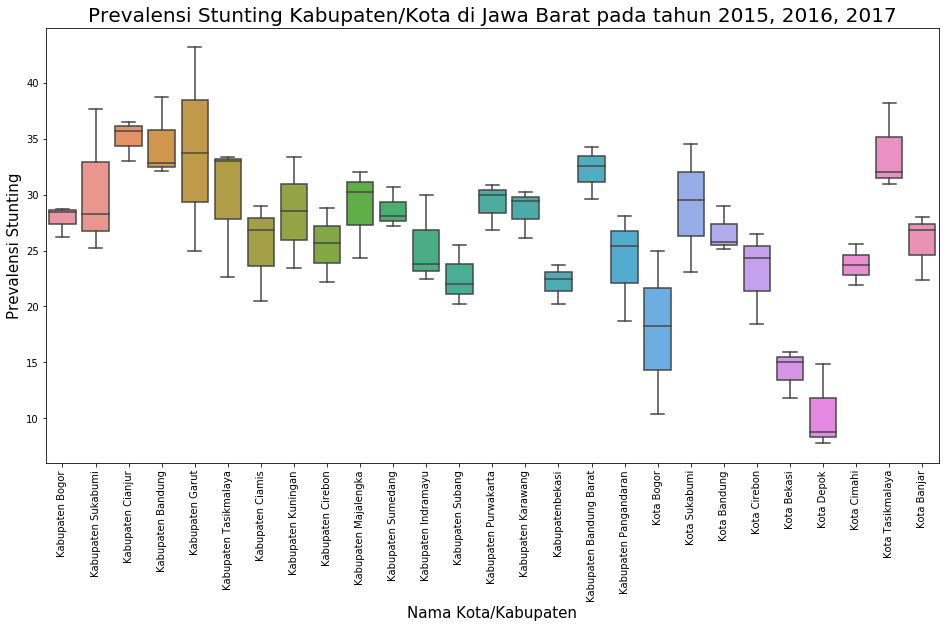

In [55]:
plt.figure (figsize=(16, 8))
plt.xticks(rotation=90)


ax = sns.boxplot("nama_kota_kabupaten", "prevalensi_stunting", data=df1)

ax.set_xlabel("Nama Kota/Kabupaten", fontsize = 15)
ax.set_ylabel("Prevalensi Stunting", fontsize = 15)
ax.set_title("Prevalensi Stunting Kabupaten/Kota di Jawa Barat pada tahun 2015, 2016, 2017", fontsize=20)

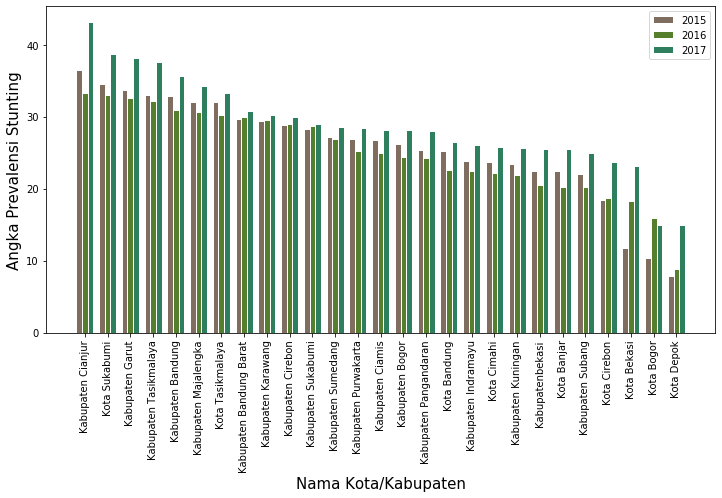

In [135]:

# set width of bar
barWidth = 0.25
 
# set height of bar
bars1 = [36.52694611,
 34.50479233,
 33.74233129,
 33.00970874,
 32.835820899999995,
 32.06349206,
 32.01219512,
 29.61783439,
 29.44983819,
 28.83435583,
 28.30188679,
 27.15231788,
 26.85714286,
 26.79738562,
 26.22377622,
 25.42372881,
 25.16703786,
 23.7804878,
 23.69230769,
 23.41772152,
 22.42424242,
 22.402597399999998,
 22.04968944,
 18.4375,
 11.79941003,
 10.41666667,
 7.807807808]
bars2 = [33.33333333,
 33.04093567,
 32.60188088,
 32.12121212,
 30.9375,
 30.6501548,
 30.21148036,
 29.9382716,
 29.53846154,
 28.96341463,
 28.75,
 26.82926829,
 25.24271845,
 24.92211838,
 24.33234421,
 24.29022082,
 22.600619199999997,
 22.5,
 22.15384615,
 21.94357367,
 20.50473186,
 20.26143791,
 20.18927445,
 18.70967742,
 18.29268293,
 15.96385542,
 8.814589666]
bars3 = [43.16762545,
 38.69955808,
 38.21619557,
 37.61764523,
 35.714353499999994,
 34.26808786,
 33.33356025,
 30.84130062,
 30.24629003,
 29.93619805,
 28.96577609,
 28.52521837,
 28.44033956,
 28.12541873,
 28.12436497,
 28.0,
 26.50570342,
 26.11489625,
 25.7575532,
 25.63285246,
 25.54546146,
 25.46060497,
 25.00052728,
 23.67607429,
 23.07825785,
 15.01491667,
 14.88125919]
 
# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
 
# Make the plot
plt.bar(r1, bars1, color='#7f6d5f', width=barWidth, edgecolor='white', label='2015')
plt.bar(r2, bars2, color='#557f2d', width=barWidth, edgecolor='white', label='2016')
plt.bar(r3, bars3, color='#2d7f5e', width=barWidth, edgecolor='white', label='2017')
 
# Add xticks on the middle of the group bars
plt.ylabel("Angka Prevalensi Stunting", fontsize= 15)
plt.xlabel("Nama Kota/Kabupaten", fontsize= 15)
plt.rcParams['figure.figsize'] = [12, 6]
plt.xticks([r + barWidth for r in range(len(bars1))], ['Kabupaten Cianjur',
 'Kota Sukabumi',
 'Kabupaten Garut',
 'Kabupaten Tasikmalaya',
 'Kabupaten Bandung',
 'Kabupaten Majalengka',
 'Kota Tasikmalaya',
 'Kabupaten Bandung Barat',
 'Kabupaten Karawang',
 'Kabupaten Cirebon',
 'Kabupaten Sukabumi',
 'Kabupaten Sumedang',
 'Kabupaten Purwakarta',
 'Kabupaten Ciamis',
 'Kabupaten Bogor',
 'Kabupaten Pangandaran',
 'Kota Bandung',
 'Kabupaten Indramayu',
 'Kota Cimahi',
 'Kabupaten Kuningan',
 'Kabupatenbekasi',
 'Kota Banjar',
 'Kabupaten Subang',
 'Kota Cirebon',
 'Kota Bekasi',
 'Kota Bogor',
 'Kota Depok'], rotation=90)
 
# Create legend & Show graphic
plt.legend()
plt.show()

# Visualisasi GeoJson

In [36]:
!pip install geojson
import geojson
import folium

In [18]:
with open('data/kota_kabupaten.geojson') as f:
    gj = geojson.load(f)
features = gj['features'][0]

In [126]:
df2015['kode_kota_kabupaten'] = df2015['kode_kota_kabupaten'].apply(str)
df2016['kode_kota_kabupaten'] = df2016['kode_kota_kabupaten'].apply(str)
df2017['kode_kota_kabupaten'] = df2017['kode_kota_kabupaten'].apply(str)

C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
C:\Users\Rega4695\miniconda3\envs\jcopml_online\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usin

In [44]:
m = folium.Map(location=[-0.789275, 113.9213257], zoom_start=4)

choropleth = folium.Choropleth(
    geo_data='kota_kabupaten.geojson',
    name='choropleth',
    data=df2015[['kode_kota_kabupaten', 'prevalensi_stunting']],
    columns=['kode_kota_kabupaten', 'prevalensi_stunting'],
    key_on='feature.properties.bps_kode',
    fill_color='YlGn',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Stunting (%)'
).add_to(m)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['bps_nama'])
)

folium.LayerControl().add_to(m)

m

In [127]:
m = folium.Map(location=[-0.789275, 113.9213257], zoom_start=4)

choropleth = folium.Choropleth(
    geo_data='kota_kabupaten.geojson',
    name='choropleth',
    data=df2016[['kode_kota_kabupaten', 'prevalensi_stunting']],
    columns=['kode_kota_kabupaten', 'prevalensi_stunting'],
    key_on='feature.properties.bps_kode',
    fill_color='GnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Stunting (%)'
).add_to(m)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['bps_nama'])
)

folium.LayerControl().add_to(m)

m

In [128]:
m = folium.Map(location=[-0.789275, 113.9213257], zoom_start=4)

choropleth = folium.Choropleth(
    geo_data='kota_kabupaten.geojson',
    name='choropleth',
    data=df2017[['kode_kota_kabupaten', 'prevalensi_stunting']],
    columns=['kode_kota_kabupaten', 'prevalensi_stunting'],
    key_on='feature.properties.bps_kode',
    fill_color='OrRd',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Stunting (%)'
).add_to(m)

choropleth.geojson.add_child(
    folium.features.GeoJsonTooltip(['bps_nama'])
)

folium.LayerControl().add_to(m)

m